# Spatial Correlation Analysis of Airbnbs & Tourism in Amsterdam

### Hypothesis
##### <i/> Airbnb rental prices increase with proximity to cultural tourism sites in the center of Amsterdam, the Netherlands.

### Exploratory Data Analysis
**Geoprocessed dataset:**
<br/>-Polygons of Amsterdam census tracts
<br/>-Average Airbnb prices per polygon
<br/>-Count per polygon of Airbnbs, OpenStreetMap tourism-attributed POIS, OpenStreetMap museums, OpenStreetMap art galleries, and nationally-registered historical buildings & monuments
<br/>
<br/>**Visualizations:**
<br/>-Contextily maps
<br/>-Point maps
<br/>-Choropleth maps
<br/>-Join plots and dispersion maps
<br/>-Hexbin maps
<br/>-Kernel density maps

In [1]:
# import libraries and packages
import warnings
warnings.filterwarnings('ignore')
import geopandas as gpd
import contextily as ctx
import folium
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import matplotlib.colors as colors
import matplotlib.patheffects as pe
import seaborn as sns
import branca.colormap as cm
import calendar
from matplotlib.patches import Ellipse
from pointpats import centrography
from folium import Element

In [2]:
# Import preprocessed data
folder_path = "data/final_processed_data/"
neighborhood_stats = gpd.read_file(folder_path + "neighborhood_stats.gpkg")
airbnb_gdf = gpd.read_file(folder_path + "airbnb_listings.gpkg")
airbnb_prices = gpd.read_file(folder_path + "airbnb_prices.gpkg")
airbnb_prices_entirespace = gpd.read_file(folder_path + "airbnb_prices_entirespace.gpkg")
airbnb_prices_entirespace_highseason = gpd.read_file(folder_path + "airbnb_prices_entirespace_highseason.gpkg")
airbnb_prices_entirespace_lowseason = gpd.read_file(folder_path + "airbnb_prices_entirespace_lowseason.gpkg")
poi_gdf = gpd.read_file(folder_path + "tourism_pois.gpkg")
museums_gdf = gpd.read_file(folder_path + "museum_pois.gpkg")
galleries_gdf = gpd.read_file(folder_path + "gallery_pois.gpkg")
monuments_gdf = gpd.read_file(folder_path + "monument_pois.gpkg")
buurten_gdf = gpd.read_file(folder_path + "neighborhood_polygons.gpkg")

if neighborhood_stats.crs != "EPSG:28992" or airbnb_gdf.crs != "EPSG:28992" or airbnb_prices.crs != "EPSG:28992" or airbnb_prices_entirespace.crs != "EPSG:28992" or airbnb_prices_entirespace_highseason.crs != "EPSG:28992" or airbnb_prices_entirespace_lowseason.crs != "EPSG:28992" or poi_gdf.crs != "EPSG:28992" or museums_gdf.crs != "EPSG:28992" or galleries_gdf.crs != "EPSG:28992" or monuments_gdf.crs != "EPSG:28992" or buurten_gdf.crs != "EPSG:28992":
    print("Convert all datasets to EPSG:28992")
else:
    print("All dataset CRS are set to EPSG:28992")

All dataset CRS are set to EPSG:28992


# Census neighborhood polygons

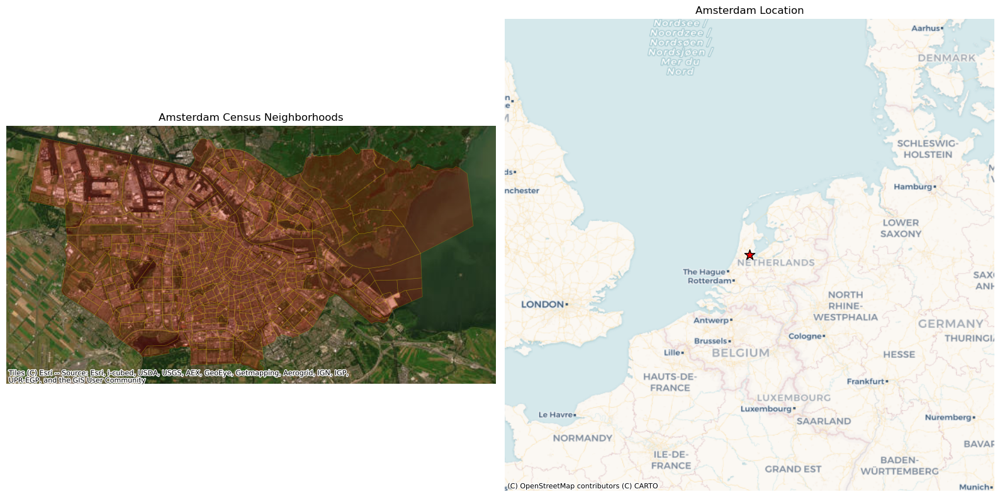

In [3]:
# Contextily basemaps
# Reproject for contextily
buurten_3857 = buurten_gdf.to_crs(epsg=3857)
fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(16, 8))
# Amsterdam map
buurten_3857.plot(ax=ax1,edgecolor="yellow",facecolor="red",alpha=0.2,linewidth=0.5)
ctx.add_basemap(ax1,source=ctx.providers.Esri.WorldImagery,crs=buurten_3857.crs)
ax1.set_title("Amsterdam Census Neighborhoods", fontsize=12)
ax1.set_axis_off()
# Netherlands Map
amsterdam_point = buurten_3857.unary_union.centroid
x_pt, y_pt = amsterdam_point.x, amsterdam_point.y
margin = 750_000
ax2.set_xlim(x_pt - margin, x_pt + margin)
ax2.set_ylim(y_pt - margin, y_pt + margin)
ctx.add_basemap(ax2,source=ctx.providers.CartoDB.Voyager,crs=buurten_3857.crs)
ax2.scatter(x_pt,y_pt,s=150,marker="*",color="red",edgecolor="black",linewidth=1,zorder=5)
ax2.set_title("Amsterdam Location", fontsize=12)
ax2.set_axis_off()
plt.tight_layout()
plt.show()

----------------------------------------------------------------------------

# Airbnb Data

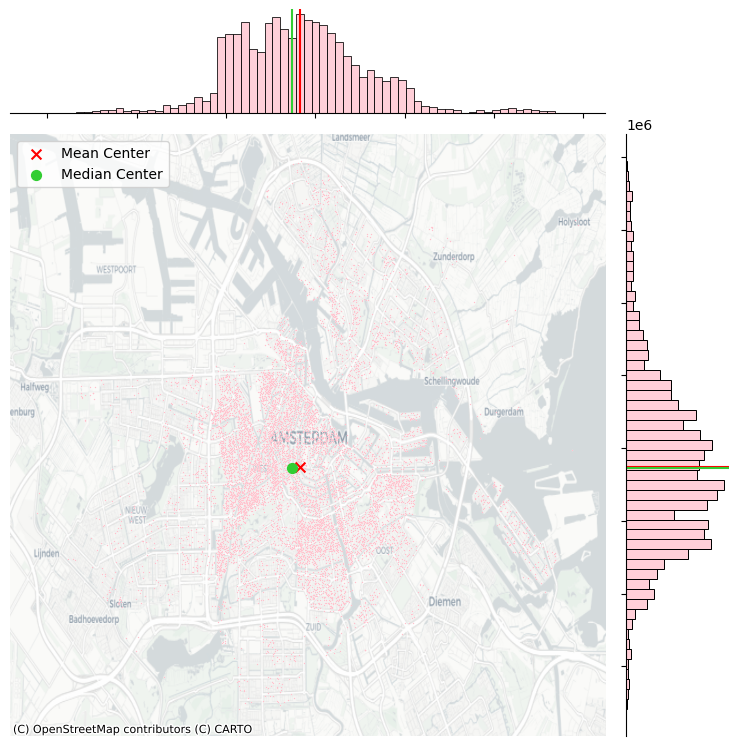

In [4]:
# Generate joint plot
airbnb_gdf_3857 = airbnb_gdf.to_crs(epsg=3857)
airbnb_gdf_3857["longitude"] = airbnb_gdf_3857.geometry.x
airbnb_gdf_3857["latitude"] = airbnb_gdf_3857.geometry.y
mean_center = centrography.mean_center(airbnb_gdf_3857[["longitude", "latitude"]])
med_center = centrography.euclidean_median(airbnb_gdf_3857[["longitude", "latitude"]])
# Generate scatterplot
joint_axes = sns.jointplot(x="longitude", y="latitude", data=airbnb_gdf_3857, s=1, height=8, color="pink")
# Add mean point and marginal lines
joint_axes.ax_joint.scatter(*mean_center, color="red", marker="x", s=50, label="Mean Center")
joint_axes.ax_marg_x.axvline(mean_center[0], color="red")
joint_axes.ax_marg_y.axhline(mean_center[1], color="red")
# Add median point and marginal lines
joint_axes.ax_joint.scatter(*med_center,color="limegreen",marker="o",s=50,label="Median Center")
joint_axes.ax_marg_x.axvline(med_center[0], color="limegreen")
joint_axes.ax_marg_y.axhline(med_center[1], color="limegreen")
# Legend
joint_axes.ax_joint.legend()
# Add basemap
ctx.add_basemap(joint_axes.ax_joint, source=ctx.providers.CartoDB.Positron)
# Clean axes
joint_axes.ax_joint.set_axis_off()
# Display
plt.show()

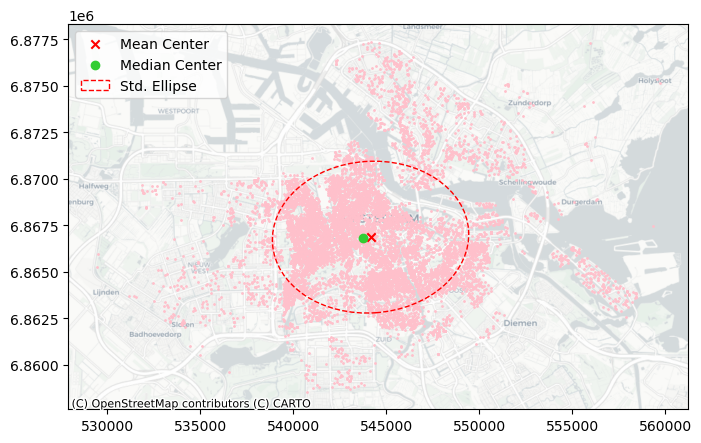

In [5]:
# Plot center & dispersion
f, ax = plt.subplots(1, figsize=(8, 5))
ax.scatter(airbnb_gdf_3857["longitude"], airbnb_gdf_3857["latitude"], s=1, color="pink")
ax.scatter(*mean_center, color="red", marker="x", label="Mean Center")
ax.scatter(*med_center, color="limegreen", marker="o", label="Median Center")
# Add standard ellipse
major, minor, rotation = centrography.ellipse(airbnb_gdf_3857[["longitude", "latitude"]])
ellipse = Ellipse(xy=mean_center,width=major * 2,height=minor * 2,angle=np.rad2deg(rotation),facecolor="none",edgecolor="red",linestyle="--",label="Std. Ellipse")
ax.add_patch(ellipse)
ax.legend()
# Add basemap
ctx.add_basemap(ax, source=ctx.providers.CartoDB.Positron)
plt.show()

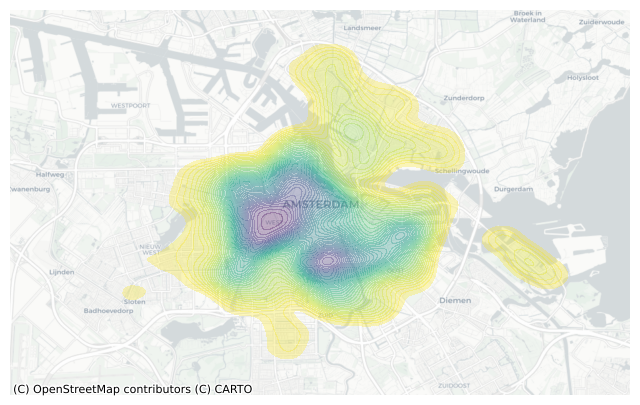

In [6]:
# Kernel density map
f, ax = plt.subplots(1, figsize=(8, 5))
sns.kdeplot(x="longitude",y="latitude",data=airbnb_gdf_3857,n_levels=50,shade=True,alpha=0.3,cmap="viridis_r")
ctx.add_basemap(ax, source=ctx.providers.CartoDB.Positron)
ax.set_axis_off()

In [7]:
# Leaflet interactive map of airbnb listings
airbnb_wgs = airbnb_prices.to_crs(epsg=4326).copy()

airbnb_wgs["price"] = pd.to_numeric(airbnb_wgs["price"], errors="coerce")
if "last_review" in airbnb_wgs.columns:
    airbnb_wgs["last_review"] = pd.to_datetime(airbnb_wgs["last_review"], errors="coerce")

center = [airbnb_wgs.geometry.y.mean(),airbnb_wgs.geometry.x.mean()]

interactive_price_map = folium.Map(location=center, zoom_start=12, tiles="CartoDB positron")

vmin = airbnb_wgs["price"].min(skipna=True)
vmax = airbnb_wgs["price"].max(skipna=True)
colormap = cm.linear.Greens_09.scale(vmin, vmax)

for _, row in airbnb_wgs.iterrows():
    geom = row.geometry
    if geom is None:
        continue

    lat = geom.y
    lon = geom.x
    price = row["price"]

    # Extra fields for tooltip
    neighbourhood = row.get("neighbourhood", "NA")
    room_type = row.get("room_type", "NA")
    last_review = row.get("last_review", pd.NA)

    if pd.isna(last_review):
        last_review_str = "NA"
    else:
        last_review_str = str(last_review).split(" ")[0]

    color = colormap(price)
    price_str = f"{price:.0f}"

    tooltip_text = (f"Neighborhood: {neighbourhood}<br>"
        f"Room type: {room_type}<br>"
        f"Last review: {last_review_str}<br>"
        f"Price: €{price_str}")

    folium.CircleMarker(location=[lat, lon],radius=3,fill=True,fill_opacity=0.9,color=None,fill_color=color,tooltip=tooltip_text).add_to(interactive_price_map)

colormap.caption = "Airbnb price (darker green = more expensive)"
colormap.add_to(interactive_price_map)
interactive_price_map

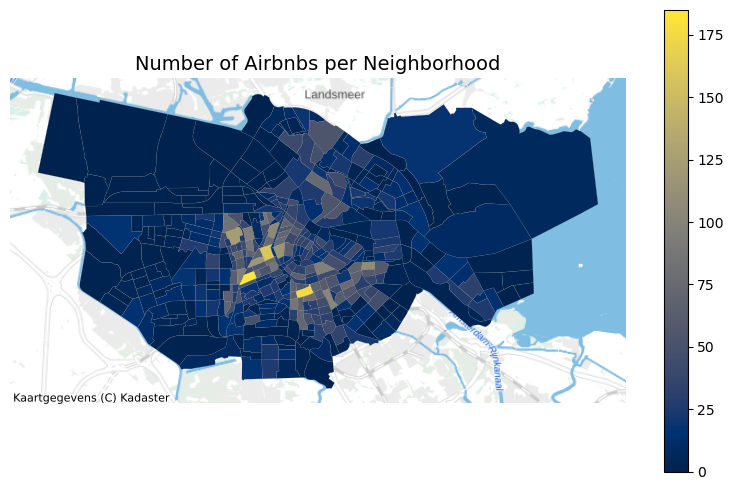

In [8]:
# Choropleth map of airbnb count per neighborhood
neighborhood_stats_3857 = neighborhood_stats.to_crs(epsg=3857)
fig, ax = plt.subplots(figsize=(8, 5))
neighborhood_stats_3857.plot(column="count_airbnbs",cmap="cividis",edgecolor="grey",linewidth=0.1,legend=True,ax=ax)
ctx.add_basemap(ax,source=ctx.providers.nlmaps.water,crs=neighborhood_stats_3857.crs)
ax.set_title("Number of Airbnbs per Neighborhood", fontsize=14)
ax.set_axis_off()
plt.tight_layout()
plt.show()

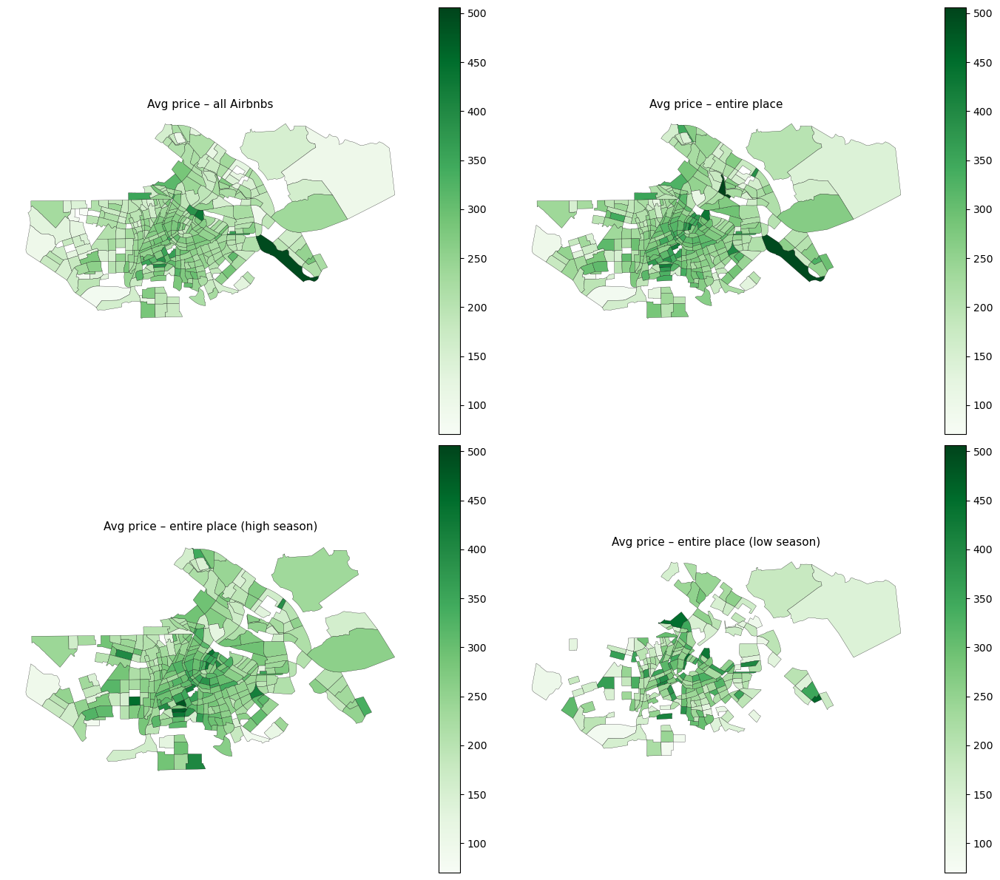

In [9]:
# Choropleth quad for airbnb prices
cols = ["avg_price_airbnb","avg_price_airbnb_entirespace","avg_price_airbnb_entirespace_highseason","avg_price_airbnb_entirespace_lowseason",]
titles = ["Avg price – all Airbnbs","Avg price – entire place","Avg price – entire place (high season)","Avg price – entire place (low season)",]
# Shared color scale across all four maps
vmin = min(neighborhood_stats[c].min() for c in cols)
vmax = max(neighborhood_stats[c].max() for c in cols)
fig, axes = plt.subplots(2, 2, figsize=(14, 12))
for ax, col, title in zip(axes.flat, cols, titles):
    neighborhood_stats.plot(column=col,cmap="Greens",edgecolor="black",linewidth=0.2,legend=True,vmin=vmin,vmax=vmax,ax=ax)
    ax.set_title(title, fontsize=11)
    ax.set_axis_off()
plt.tight_layout()
plt.show()

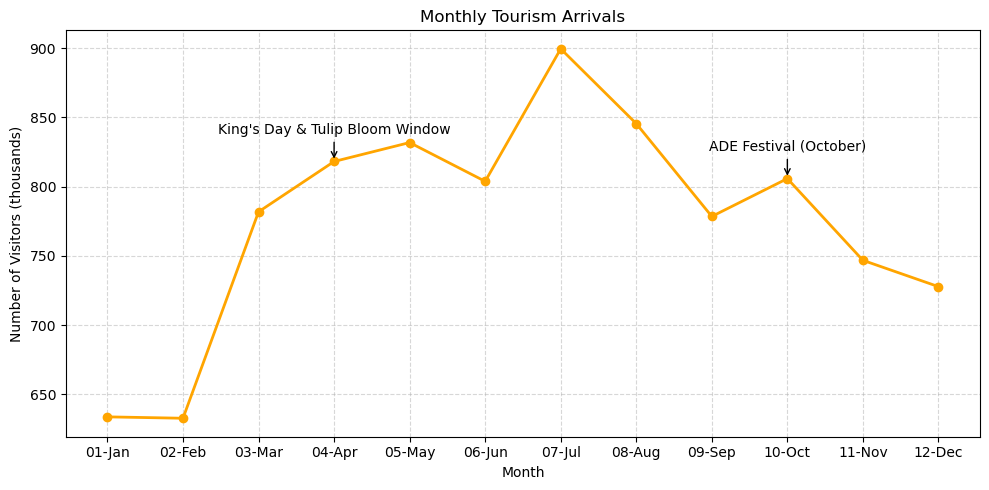

In [10]:
# Tourism visitors stats
visitorstats_df = pd.read_csv("data/tourism_statistics/amsterdam_tourist_arrivals.csv")
## Look at Amsterdam tourism arrivals to determine high season vs low season
visitorstats_df = visitorstats_df.drop(columns=["Unnamed: 12"], errors="ignore")
visitorstats_long = visitorstats_df.melt(var_name="Month", value_name="Visitors")
visitorstats_long["Visitors"] = pd.to_numeric(visitorstats_long["Visitors"], errors="coerce")
month_order = ["01-Jan", "02-Feb", "03-Mar", "04-Apr", "05-May", "06-Jun","07-Jul", "08-Aug", "09-Sep", "10-Oct", "11-Nov", "12-Dec"]
visitorstats_long["Month"] = pd.Categorical(visitorstats_long["Month"], categories=month_order, ordered=True)
visitorstats_long = visitorstats_long.sort_values("Month")

plt.figure(figsize=(10, 5))
plt.plot(visitorstats_long["Month"].astype(str),visitorstats_long["Visitors"],marker="o", color="orange", linewidth=2)

# annotate with note about King's Day & Tulip Bloom
apr_mask = visitorstats_long["Month"] == "04-Apr"
x_apr = visitorstats_long.loc[apr_mask, "Month"].iloc[0]
y_apr = visitorstats_long.loc[apr_mask, "Visitors"].iloc[0]
plt.annotate("King's Day & Tulip Bloom Window",xy=(x_apr, y_apr),xytext=(0, 20),textcoords="offset points",arrowprops=dict(arrowstyle="->", linewidth=1),ha="center")
# annotate with note about October ADE
oct_mask = visitorstats_long["Month"] == "10-Oct"
x_oct = visitorstats_long.loc[oct_mask, "Month"].astype(str).iloc[0]
y_oct = visitorstats_long.loc[oct_mask, "Visitors"].iloc[0]
plt.annotate("ADE Festival (October)",xy=(x_oct, y_oct),xytext=(0, 20),textcoords="offset points",arrowprops=dict(arrowstyle="->", linewidth=1),ha="center")

plt.title("Monthly Tourism Arrivals")
plt.xlabel("Month")
plt.ylabel("Number of Visitors (thousands)")
plt.grid(True, linestyle="--", alpha=0.5)
plt.tight_layout()
plt.show()

    review_month       price
0            1.0  242.390244
1            2.0  219.630435
2            3.0  210.909091
3            4.0  265.990536
4            5.0  248.368957
5            6.0  259.353808
6            7.0  276.509804
7            8.0  257.535805
8            9.0  250.720617
9           10.0  273.420000
10          11.0  236.142857
11          12.0  227.875000
   review_year       price
0       2017.0  218.833333
1       2018.0  230.142857
2       2019.0  262.529412
3       2020.0  248.000000
4       2021.0  184.555556
5       2022.0  279.829268
6       2023.0  267.417266
7       2024.0  256.098876
8       2025.0  257.691436


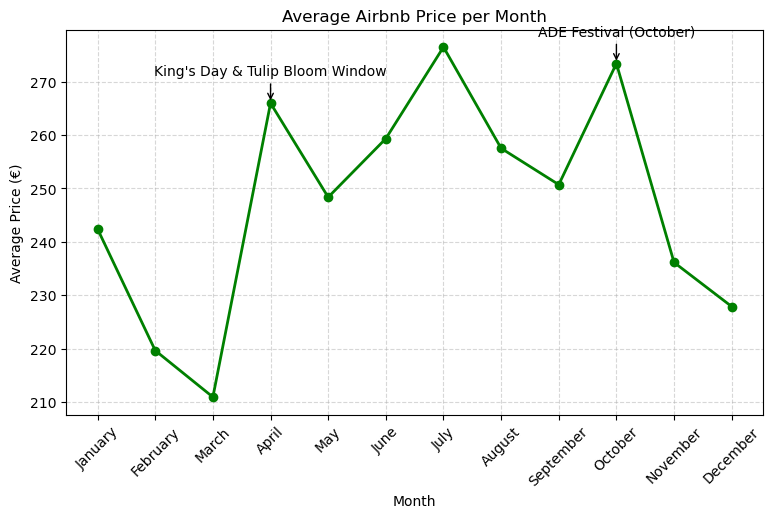

In [11]:
# Calculate average airbnb price per month
# Group by month and calculate mean price
avg_price_by_month = (airbnb_prices_entirespace.groupby("review_month")["price"].mean().reset_index().sort_values("review_month"))
print(avg_price_by_month)
# Calculate average price per year
avg_price_by_year = (airbnb_prices_entirespace.groupby("review_year")["price"].mean().reset_index().sort_values("review_year"))
print(avg_price_by_year)

avg_price_by_month["month_name"] = avg_price_by_month["review_month"].apply(lambda x: calendar.month_name[int(x)] if pd.notna(x) else None)

# Plot prices by month
plt.figure(figsize=(9, 5))
plt.plot(avg_price_by_month["review_month"],avg_price_by_month["price"],marker="o",color="green",linewidth=2)

# annotate with note about King's Day & Tulip Bloom
apr_mask = avg_price_by_month["review_month"] == 4
x_apr = avg_price_by_month.loc[apr_mask, "review_month"].iloc[0]
y_apr = avg_price_by_month.loc[apr_mask, "price"].iloc[0]
plt.annotate("King's Day & Tulip Bloom Window",xy=(x_apr, y_apr),xytext=(0, 20),textcoords="offset points",arrowprops=dict(arrowstyle="->", linewidth=1),ha="center")
# annotate with note about October ADE
oct_mask = avg_price_by_month["review_month"] == 10
x_oct = avg_price_by_month.loc[oct_mask, "review_month"].iloc[0]
y_oct = avg_price_by_month.loc[oct_mask, "price"].iloc[0]
plt.annotate("ADE Festival (October)",xy=(x_oct, y_oct),xytext=(0, 20),textcoords="offset points",arrowprops=dict(arrowstyle="->", linewidth=1),ha="center")

plt.title("Average Airbnb Price per Month")
plt.xlabel("Month")
plt.ylabel("Average Price (€)")
plt.xticks(avg_price_by_month["review_month"],avg_price_by_month["month_name"],rotation=45)
plt.grid(True, linestyle="--", alpha=0.5)
plt.show()

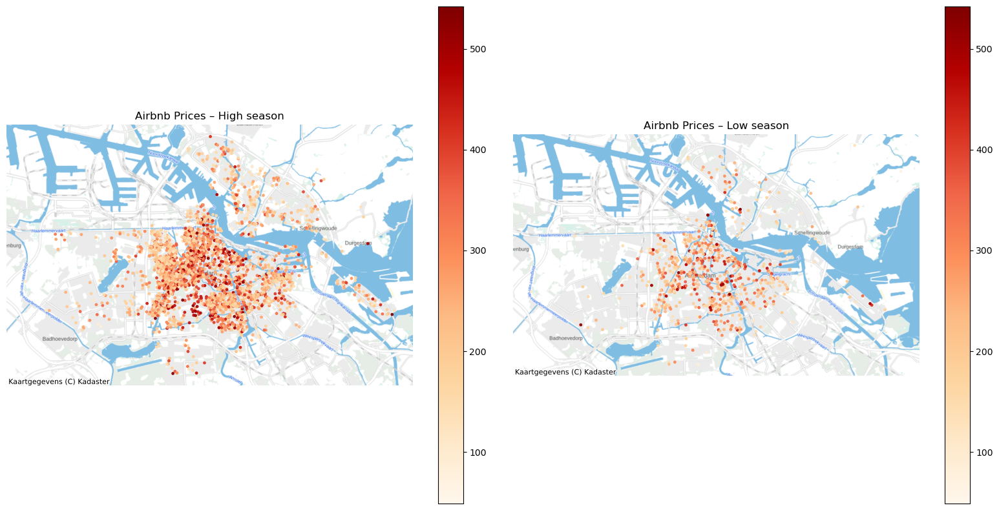

In [12]:
# Generate point maps of high vs low season airbnb prices
high_3857 = airbnb_prices_entirespace_highseason.to_crs(epsg=3857)
low_3857  = airbnb_prices_entirespace_lowseason.to_crs(epsg=3857)

vmin = min(high_3857["price"].min(), low_3857["price"].min())
vmax = max(high_3857["price"].max(), low_3857["price"].max())
fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(16, 8))

# High season prices
high_3857.plot(ax=ax1,column="price",cmap="OrRd",markersize=6,alpha=0.9,legend=True,vmin=vmin,vmax=vmax)
ctx.add_basemap(ax1, source=ctx.providers.nlmaps.water, crs=high_3857.crs)
ax1.set_title("Airbnb Prices – High season", fontsize=12)
ax1.set_axis_off()

# Low season prices
low_3857.plot(ax=ax2,column="price",cmap="OrRd",markersize=6,alpha=0.9,legend=True,vmin=vmin,vmax=vmax)
ctx.add_basemap(ax2, source=ctx.providers.nlmaps.water, crs=low_3857.crs)
ax2.set_title("Airbnb Prices – Low season", fontsize=12)
ax2.set_axis_off()

plt.tight_layout()
plt.show()

---------------------------------------------------------------------

# Nationally Registered Monuments

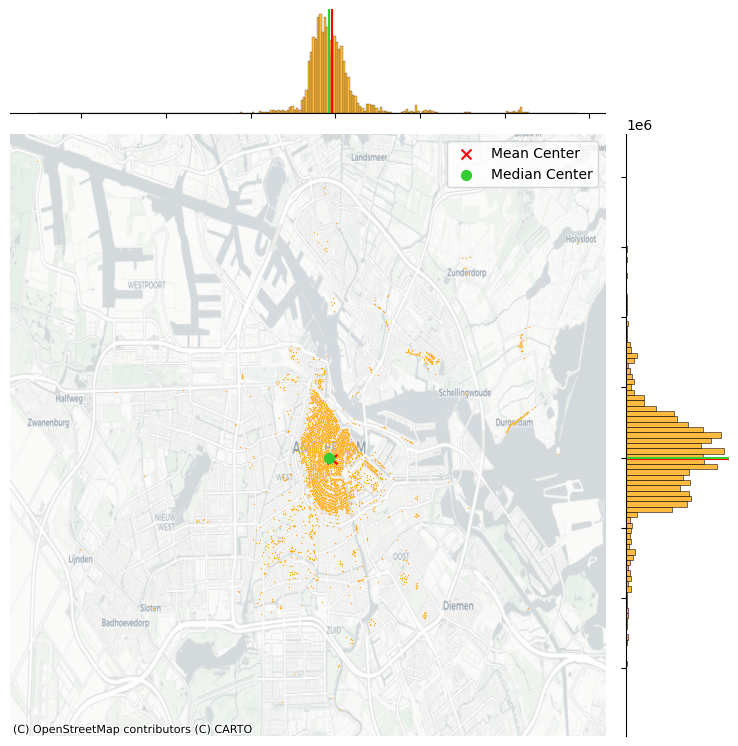

In [13]:
# Joint Plot Map
monuments_gdf_3857 = monuments_gdf.to_crs(epsg=3857)
monuments_gdf_3857["longitude"] = monuments_gdf_3857.geometry.x
monuments_gdf_3857["latitude"] = monuments_gdf_3857.geometry.y
mean_center = centrography.mean_center(monuments_gdf_3857[["longitude", "latitude"]])
med_center = centrography.euclidean_median(monuments_gdf_3857[["longitude", "latitude"]])
# Generate scatterplot
joint_axes = sns.jointplot(x="longitude", y="latitude", data=monuments_gdf_3857, s=1, height=8, color="orange")
# Add mean point and marginal lines
joint_axes.ax_joint.scatter(*mean_center, color="red", marker="x", s=50, label="Mean Center")
joint_axes.ax_marg_x.axvline(mean_center[0], color="red")
joint_axes.ax_marg_y.axhline(mean_center[1], color="red")
# Add median point and marginal lines
joint_axes.ax_joint.scatter(*med_center,color="limegreen",marker="o",s=50,label="Median Center")
joint_axes.ax_marg_x.axvline(med_center[0], color="limegreen")
joint_axes.ax_marg_y.axhline(med_center[1], color="limegreen")
# Legend
joint_axes.ax_joint.legend()
# Add basemap
ctx.add_basemap(joint_axes.ax_joint, source=ctx.providers.CartoDB.Positron)
# Clean axes
joint_axes.ax_joint.set_axis_off()
# Display
plt.show()

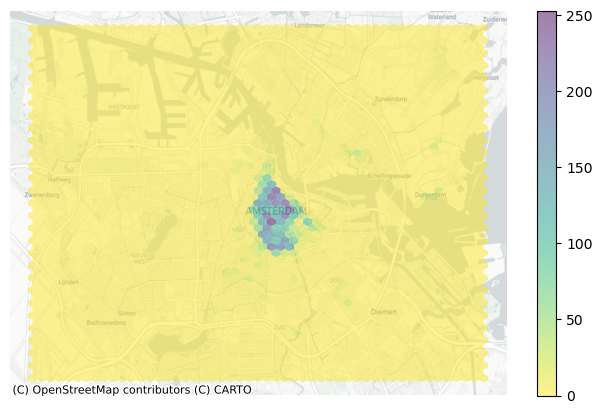

In [14]:
# Hexbin map
# Set up figure and axis
f, ax = plt.subplots(1, figsize=(8, 5))
hb = ax.hexbin(monuments_gdf_3857["longitude"],monuments_gdf_3857["latitude"],gridsize=50,linewidths=0,alpha=0.5,cmap="viridis_r")
# Add basemap
ctx.add_basemap(ax, source=ctx.providers.CartoDB.Positron)
# Add colorbar
plt.colorbar(hb)
# Remove axes
ax.set_axis_off()

In [15]:
# Leaflet interactive map for monuments
monuments_wgs = monuments_gdf.to_crs(epsg=4326).copy()
center = [monuments_wgs.geometry.y.mean(),monuments_wgs.geometry.x.mean()]
interactive_monuments_map = folium.Map(location=center, zoom_start=12, tiles="Esri.WorldImagery")
for _, row in monuments_wgs.iterrows():
    geom = row.geometry
    if geom is None:
        continue
    lat = geom.y
    lon = geom.x
    herkomst = row.get("herkomst", "NA")
    subcategor = row.get("subcategor", "NA")

    tooltip_text = f"Origin: {herkomst}<br>Subcategory: {subcategor}"
    folium.CircleMarker(location=[lat, lon],radius=1.5,color="orange",fill=True,fill_color="orange",popup=tooltip_text,tooltip=tooltip_text).add_to(interactive_monuments_map)
title_html = """<div style="position:fixed; top:10px; left:50%; transform:translateX(-50%); z-index:9999; background-color:white; padding:6px 12px; border:1px solid #ccc; border-radius:4px; font-size:14px;"><b>Nationally-registered Monuments and Historic Buildings in Amsterdam</b></div>"""
interactive_monuments_map.get_root().html.add_child(Element(title_html))
interactive_monuments_map

--------------------------------------------

# Tourism POI Data

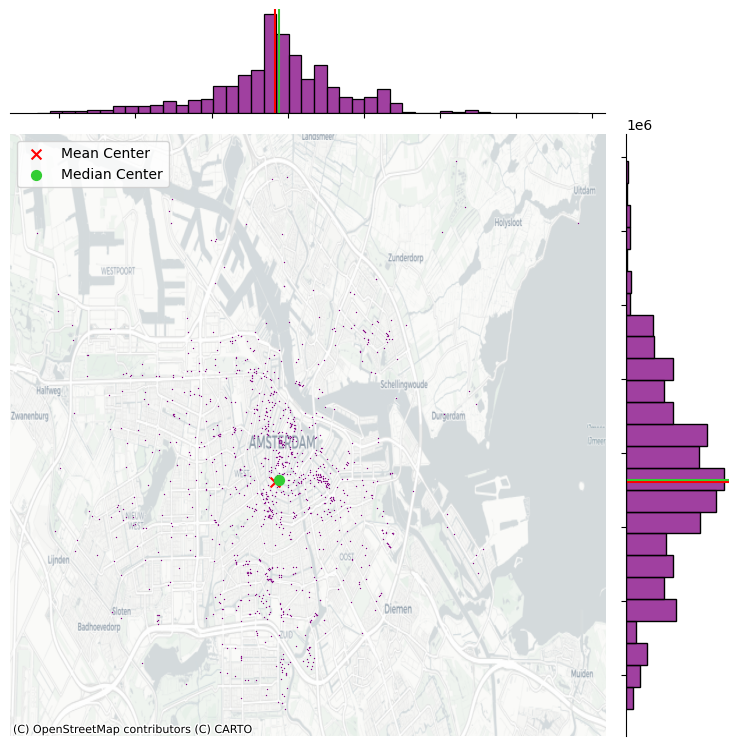

In [16]:
# Generate joint plot
poi_gdf_3857 = poi_gdf.to_crs(epsg=3857)
poi_gdf_3857["longitude"] = poi_gdf_3857.geometry.x
poi_gdf_3857["latitude"] = poi_gdf_3857.geometry.y
mean_center = centrography.mean_center(poi_gdf_3857[["longitude", "latitude"]])
med_center = centrography.euclidean_median(poi_gdf_3857[["longitude", "latitude"]])
# Generate scatterplot
joint_axes = sns.jointplot(x="longitude", y="latitude", data=poi_gdf_3857, s=1, height=8, color="purple")
# Add mean point and marginal lines
joint_axes.ax_joint.scatter(*mean_center, color="red", marker="x", s=50, label="Mean Center")
joint_axes.ax_marg_x.axvline(mean_center[0], color="red")
joint_axes.ax_marg_y.axhline(mean_center[1], color="red")
# Add median point and marginal lines
joint_axes.ax_joint.scatter(*med_center,color="limegreen",marker="o",s=50,label="Median Center")
joint_axes.ax_marg_x.axvline(med_center[0], color="limegreen")
joint_axes.ax_marg_y.axhline(med_center[1], color="limegreen")
# Legend
joint_axes.ax_joint.legend()
# Add basemap
ctx.add_basemap(joint_axes.ax_joint, source=ctx.providers.CartoDB.Positron)
# Clean axes
joint_axes.ax_joint.set_axis_off()
# Display
plt.show()

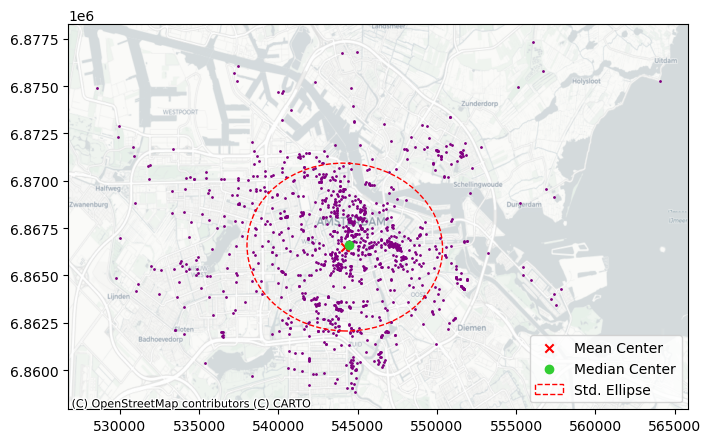

In [17]:
# Plot center & dispersion
f, ax = plt.subplots(1, figsize=(8, 5))
ax.scatter(poi_gdf_3857["longitude"], poi_gdf_3857["latitude"], s=1, color="purple")
ax.scatter(*mean_center, color="red", marker="x", label="Mean Center")
ax.scatter(*med_center, color="limegreen", marker="o", label="Median Center")
# Add standard ellipse
major, minor, rotation = centrography.ellipse(poi_gdf_3857[["longitude", "latitude"]])
ellipse = Ellipse(xy=mean_center,width=major * 2,height=minor * 2,angle=np.rad2deg(rotation),facecolor="none",edgecolor="red",linestyle="--",label="Std. Ellipse")
ax.add_patch(ellipse)
ax.legend()
# Add basemap
ctx.add_basemap(ax, source=ctx.providers.CartoDB.Positron)
plt.show()

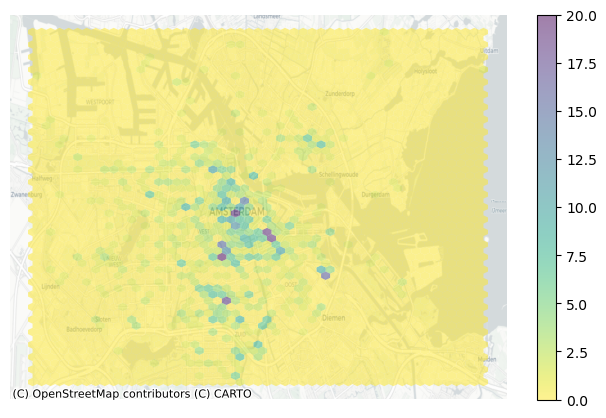

In [18]:
# Hexbin map
f, ax = plt.subplots(1, figsize=(8, 5))
hb = ax.hexbin(poi_gdf_3857["longitude"],poi_gdf_3857["latitude"],gridsize=50,linewidths=0,alpha=0.5,cmap="viridis_r",)
ctx.add_basemap(ax, source=ctx.providers.CartoDB.Positron)
plt.colorbar(hb)
ax.set_axis_off()

In [19]:
# Leaflet interactive map of tourism POIs
poi_wgs = poi_gdf.to_crs(epsg=4326).copy()
center = [poi_wgs.geometry.y.mean(),poi_wgs.geometry.x.mean()]
interactive_poi_map = folium.Map(location=center, zoom_start=12, tiles="Esri.WorldImagery")
for _, row in poi_wgs.iterrows():
    geom = row.geometry
    if geom is None:
        continue
    lat = geom.y
    lon = geom.x
    name = row.get("name", "NA")
    tourism = row.get("tourism", "NA")

    tooltip_text = f"Name: {name}<br>Tourism: {tourism}"
    folium.CircleMarker(location=[lat, lon],radius=1.5,color="purple",fill=True,fill_color="purple",popup=tooltip_text,tooltip=tooltip_text).add_to(interactive_poi_map)
title_html = """<div style="position:fixed; top:10px; left:50%; transform:translateX(-50%); z-index:9999; background-color:white; padding:6px 12px; border:1px solid #ccc; border-radius:4px; font-size:14px;"><b>OpenStreetMap Tourism POIs in Amsterdam</b></div>"""
interactive_poi_map.get_root().html.add_child(Element(title_html))
interactive_poi_map

# Monuments, Museums, Galleries

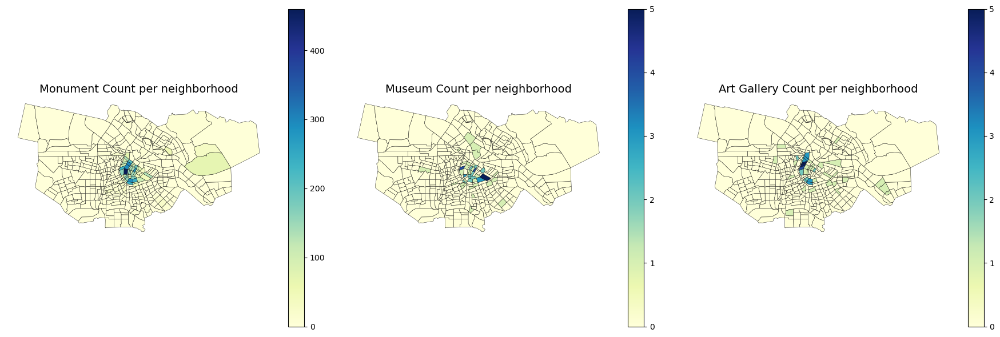

In [20]:
# Chroropleth trio
cols = ["count_monuments", "count_museums", "count_galleries"]
titles = ["Monument Count per neighborhood", "Museum Count per neighborhood", "Art Gallery Count per neighborhood"]
fig, axes = plt.subplots(1, 3, figsize=(18, 6))
for ax, col, title in zip(axes, cols, titles):
    vmin = neighborhood_stats[col].min()
    vmax = neighborhood_stats[col].max()
    neighborhood_stats.plot(column=col,cmap="YlGnBu",edgecolor="black",linewidth=0.3,legend=True,vmin=vmin,vmax=vmax,ax=ax)
    ax.set_title(title, fontsize=14)
    ax.set_axis_off()
plt.tight_layout()
plt.show()

------------------------------------------------------------------------------------------